<img src="media/Code_Canvas_2.png" width="500" height="200" align='center'>

# CodeCanvas ⚡: Crafting Art with Neural Style Transfer Models


---



Welcome to "CodeCanvas: Crafting Art with Neural Style Transfer Models." In this Jupyter Notebook, we embark on a creative journey into the realm of computational aesthetics, exploring the fascinating world of neural style transfer. Style transfer, a captivating application of deep learning, allows us to blend the content of one image with the artistic style of another, resulting in visually stunning and unique compositions.


> **Style transfer**, *as described in the previous response, is a technique where the visual style of one image is applied to the content of another image. The goal is to generate a new image that combines the content of one image with the artistic style of another. It often involves the use of deep neural networks to extract and transfer features between images.*



## Overview

Artistic expression has found a new canvas in the form of algorithms and neural networks. In this project, we delve into the intricacies of neural style transfer, unraveling the underlying concepts and implementing cutting-edge techniques using the PyTorch framework. We will witness how convolutional neural networks (CNNs) can be harnessed to transfer the artistic essence of one image onto another, creating a harmonious fusion of content and style.

## Key Objectives:
*   **Understanding Style Transfer:** Gain insights into the theoretical foundations of neural style transfer and the key concepts driving this innovative technique.

*   **Implementing Algorithms:** Dive into the code and witness the magic as we implement neural style transfer algorithms. We'll explore how deep neural networks can capture the stylistic features of famous artworks and apply them to our own images.

*   **Creative Exploration:** Unleash your creativity! Experiment with different style images, tweak parameters, and observe the transformative power of neural networks in crafting unique digital masterpieces.

*   **Technical Insights:** Gain a deeper understanding of the technical aspects behind style transfer, including the role of convolutional layers, feature extraction, and the optimization process.

### Importing libraries

In [1]:
import cv2
import os
import torch
import numpy as np
import PIL.Image as Image
import torch.optim as optim
import matplotlib.pyplot as plt
from torchvision import transforms, models

In [2]:
torch.__version__

'2.1.1+cpu'

### Style Transfer Setup & Initialization

> **for param in vgg.parameters():** param.requires_grad_(False): To prevent modifying the pre-trained weights during training, we set requires_grad to False for all parameters in the VGG model. This ensures that the model's weights remain fixed during the style transfer optimization process.

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
vgg = models.vgg19(pretrained=True).features
for param in vgg.parameters():
  param.requires_grad_(False)

vgg.to(device)

C:\Users\Admin\anaconda3\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Admin\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

### Image Loading and Preprocessing

In this section, we focus on the crucial task of loading and preprocessing images for our neural style transfer project. Properly preparing our input images ensures that they align with the requirements of the style transfer algorithm and the pretrained VGG model.



*   We use the Python Imaging Library (PIL) to open the image specified by img_path and convert it to the RGB color space. This ensures consistency in the number of channels, making it suitable for subsequent processing.

*   We define a series of image transformations using transforms.Compose. These include resizing the image to the specified size, converting it to a PyTorch tensor, and normalizing pixel values to the range [-1, 1].
> *`transforms.ToTensor()`* converts the image to a PyTorch tensor *transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))* then normalizes the tensor by subtracting the mean and dividing by the standard deviation, resulting in a tensor with values in the range [-1, 1].

*   The function returns the preprocessed image as a PyTorch tensor. The unsqueeze(0) adds a batch dimension, making it compatible with the input requirements of neural networks.





In [5]:
def load_img(img_path, img_size = 512, shape = None):
  img = Image.open(img_path).convert('RGB')

  if max(img.size) < img_size:
    img_size = max(img.size)

  if shape is not None:
    img_size = shape

  transform = transforms.Compose([transforms.Resize(img_size),
                                  transforms.ToTensor(),
                                  transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

  return transform(img).unsqueeze(0)

### Processing NumPy Conversation for Image Visualization

In [6]:
def np_convert(tensor):

  img = tensor.cpu().clone().detach().numpy()

  # remove singleton dimensions to simplify the array structure
  img = img.squeeze()

  # transpose the dimensions to change the order from PyTorch's channel-first format (C x H x W) to the more common channel-last format (H x W x C) used by Matplotlib
  img = img.transpose(1, 2, 0)

  # Reverse the normalization applied during image preprocessing & pixel values are within the valid range [0, 1].
  img = img * np.array((0.5, 0.5, 0.5)) + np.array((0.5, 0.5, 0.5))

  return img.clip(0, 1) # clip pixel values to the valid range [0, 1] to prevent any outliers.

### Feature Extraction from Input Images

This ***`get_features`*** function is instrumental in capturing relevant information from the input image at different levels of abstraction. The extracted features are subsequently utilized in the style transfer process to match and blend content and style representations effectively.

This utility function acts as a bridge between the input image and the deep neural network, providing extraction of essential features for the neural style transfer algorithm.

In [7]:
def get_features(img, model):
  layers = {'0': 'conv1_1', '5': 'conv2_1', '10': 'conv3_1', '19': 'conv4_1', '21': 'conv4_2', '28': 'conv5_1'}

  features = {}

  for name, layer in model._modules.items():
    img = layer(img)

    if name in layers:
      features[layers[name]] = img

  return features

#### Calculating Gram matrix



>  *The **Gram matrix** is a mathematical concept used in the context of neural style transfer, a technique that combines the content of one image with the style of another. The Gram matrix is particularly important for capturing the style of an image.*



The ***gram_matrix*** function is a critical component in style transfer algorithms. It quantifies the stylistic information of feature maps, enabling the algorithm to match and transfer the artistic style from one image to another.

In [8]:
def gram_matrix(tensor):
  _, c, h, w = tensor.size()

  tensor = tensor.view(c, h*w)

  gram= torch.mm(tensor, tensor.t())

  return gram

#### Content & Style Image loading to model

In [9]:
# content = load_img(os.path.join(IMAGES, 'shrek_PNG3.png'), shape=(512, 512)).to(device)
# style = load_img(os.path.join(IMAGES, 'spaghetti.jpg'), shape=(512, 512)).to(device)

content = load_img('modi.jpg', shape=(512, 512)).to(device)
style = load_img('chitah.jpg', shape=(512, 512)).to(device)


#### Visualizing Both Image side-by-side

(-0.5, 511.5, 511.5, -0.5)

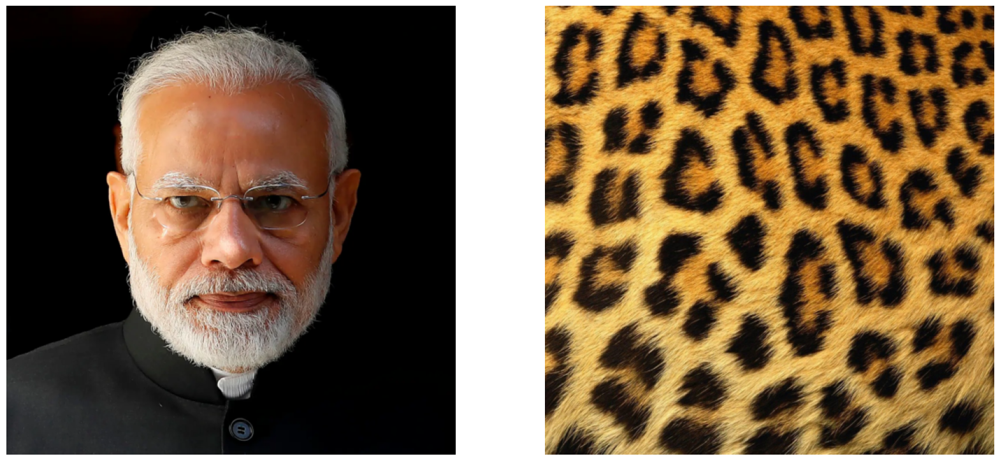

In [10]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

ax1.imshow(np_convert(content))
ax1.axis('off')

ax2.imshow(np_convert(style))
ax2.axis('off')


### Feature Extraction: Capturing Content and Style

Here, our focus is on extracting features from both the content and style images using the VGG-19 model. Feature extraction is a pivotal step in neural style transfer, as it involves capturing the relevant information from different layers of the deep neural network

The extracted features will play a crucial role in the upcoming steps of neural style transfer. These features represent the content and style characteristics of the input images, forming the basis for the creation of a stylized output.

In [11]:
content_features = get_features(content, vgg)
style_features = get_features(style, vgg)

**Significance of Style Grams:**
These computed Gram matrices are critical in the calculation of style loss during the neural style transfer optimization process. The Gram matrix represents the style information of the image at different scales, capturing the essence of textures, patterns, and structures.

In [12]:
style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

### Setting Style and Content Weights
 We define the weights for content and style in the neural style transfer algorithm. These weights play a crucial role in determining the balance between preserving the content of the original image and incorporating the artistic style of the reference image.


> **Significance of Weights:** The choice of style weights, content weight, and style weight significantly influences the visual outcome of the neural style transfer process. Adjusting these weights allows for customization of the final stylized image based on the desired artistic effect.


###### Importance of Weight:
*   The ***content_weight*** represents the importance given to preserving the content of the original image. This weight influences how much the generated image will resemble the content image.
*   The ***style_weight*** is a multiplier applied to the overall style loss. A higher style_weight emphasizes the importance of matching the artistic style of the reference image in the generated result.



In [13]:
style_weights = {'conv1_1': 1.0, 'conv2_1': 0.75, 'conv3_1': 0.2, 'conv4_1': 0.2, 'conv5_1': 0.2}

content_weight = 1
style_weight = 1e6

### Defining Target Image for Optimization
The target image is the variable that will be optimized to minimize the content and style losses. Through iterative updates, guided by these losses, the target image evolves to strike a balance between content preservation and style incorporation.

```
.requires_grad_(True)
```

We set "***requires_grad***" to "***True***" for the target image. This flag indicates that gradients with respect to this tensor should be computed during backpropagation. It enables the target image to be updated during the optimization process.


In [14]:
target = content.clone().requires_grad_(True).to(device)

### Optimization Setup for Neural Style Transfer

We configure the optimization process for the neural style transfer algorithm. We set parameters such as the optimizer, the number of optimization steps, and define variables for visualization purposes.



*   The ***'verbose'*** parameter determines how often we print or visualize the progress during the optimization process. In this case, an update will be displayed every 300 steps.
*   We use the Adam optimizer to update the target image during optimization. The learning rate ***'(lr)'*** is set to 0.003.
*   The ***'num_steps'*** variable defines the total number of optimization steps that will be performed.
*  ***'img_array'*** is a NumPy array that will store selected frames from the optimization process for later visualization. It is sized to store 300 frames.
*   ***'cap_frame'*** determines how often we capture frames for visualization. In this case, a frame will be captured every cap_frame steps.
*   '***ctr***' is a counter variable used to track the number of steps taken during optimization. It starts at 0.

The ***Adam optimizer*** is employed to update the target image over a specified number of steps, and frames are captured for visualization purposes. Adjusting these parameters allows for fine-tuning the style transfer process.


In [15]:
verbose = 300
optimizer = optim.Adam([target], lr=0.003)
num_steps = 12000

height, width, channels = np_convert(target).shape
img_array = np.empty(shape=(300, height, width, channels))
cap_frame = num_steps/300

ctr = 0


### Iterative Optimazation Loop

Here, The loop iteratively updates the target image based on content and style losses, providing a visual representation of the stylized image at selected steps.


1. **Feature Extraction for Target:** We extract features from the current target image using the VGG-19 model.
2. **Content Loss Calculation:** The content loss is calculated as the mean squared difference between the features of the target and content images at a specific layer (conv4_2).
3. **Style Loss Calculation:** The style loss is calculated for each style layer using the Gram matrices. The contributions from different layers are weighted based on the defined `style_weights`.

Step 300, Total Loss: 6785943.5


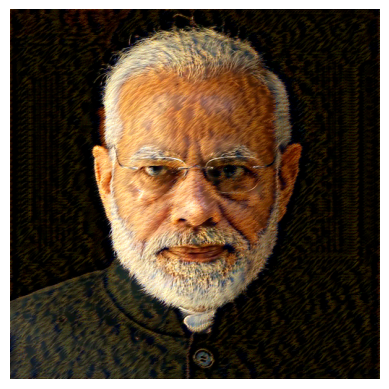

Step 600, Total Loss: 3237365.5


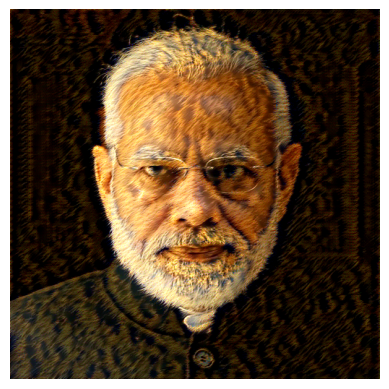

Step 900, Total Loss: 2004673.375


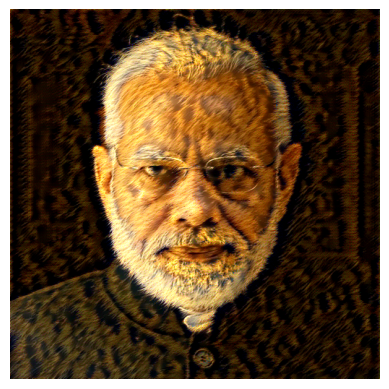

Step 1200, Total Loss: 1358188.0


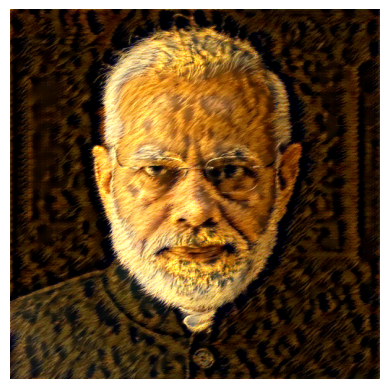

Step 1500, Total Loss: 972787.25


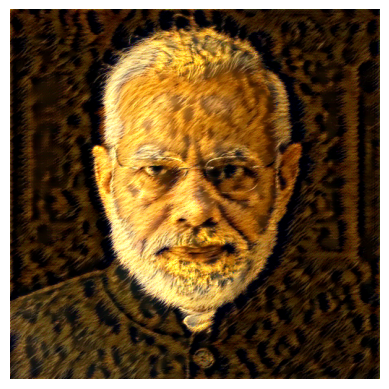

Step 1800, Total Loss: 731715.0625


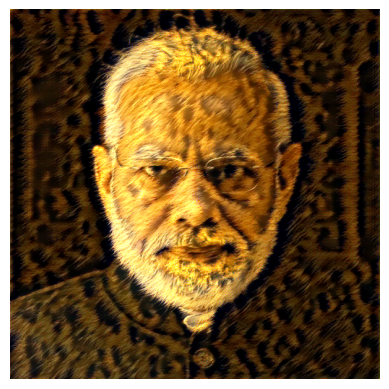

Step 2100, Total Loss: 570331.625


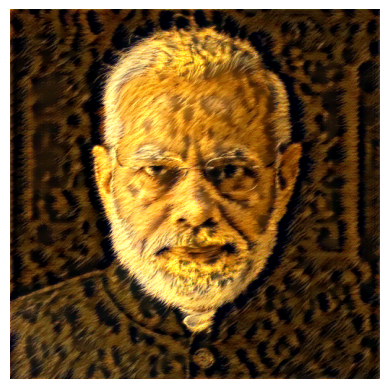

Step 2400, Total Loss: 453516.71875


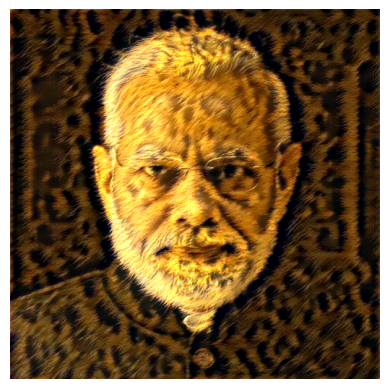

Step 2700, Total Loss: 363075.96875


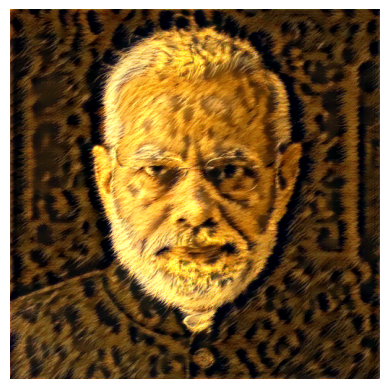

Step 3000, Total Loss: 290406.34375


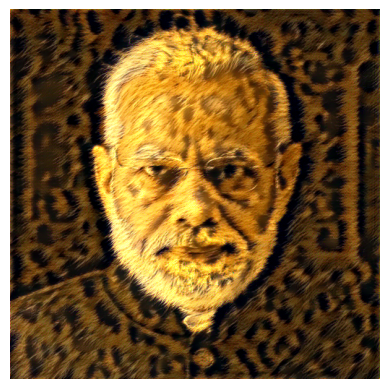

Step 3300, Total Loss: 230888.625


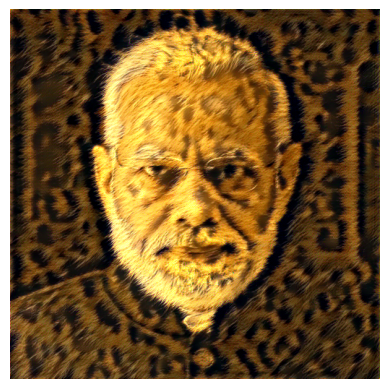

Step 3600, Total Loss: 181781.796875


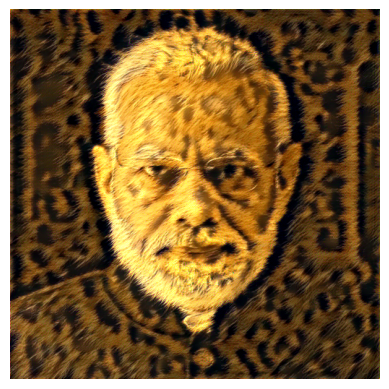

Step 3900, Total Loss: 141477.1875


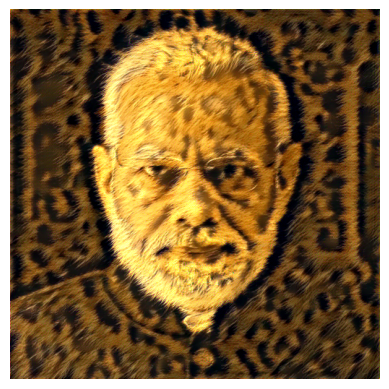

Step 4200, Total Loss: 108779.515625


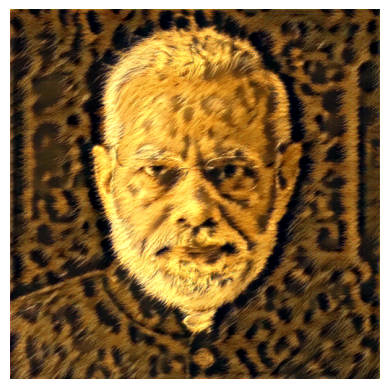

Step 4500, Total Loss: 82791.21875


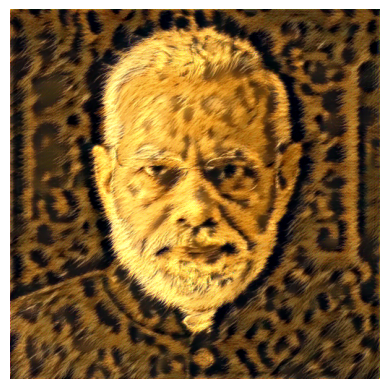

Step 4800, Total Loss: 62594.40625


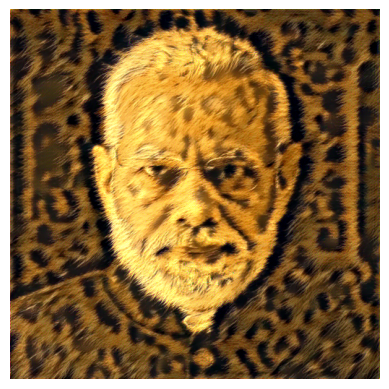

Step 5100, Total Loss: 47192.109375


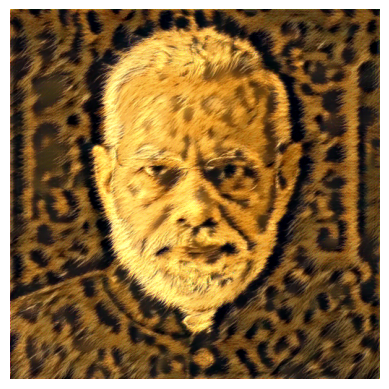

Step 5400, Total Loss: 35784.40234375


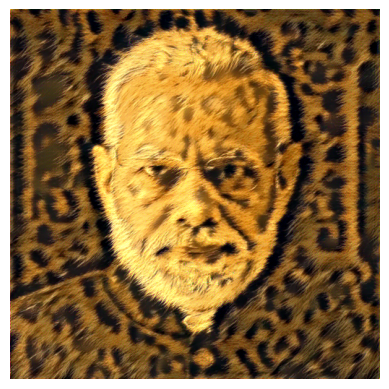

Step 5700, Total Loss: 27651.63671875


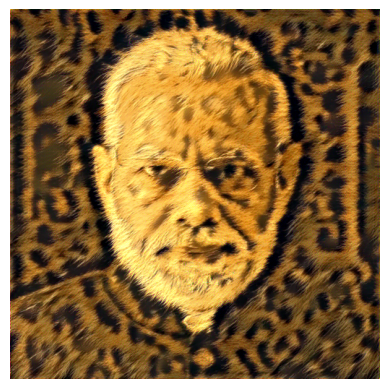

Step 6000, Total Loss: 21767.439453125


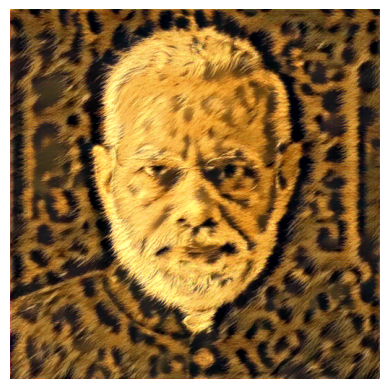

Step 6300, Total Loss: 17829.974609375


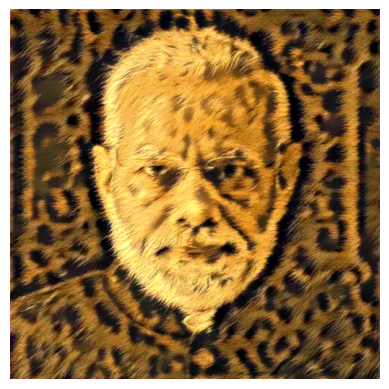

Step 6600, Total Loss: 14854.375


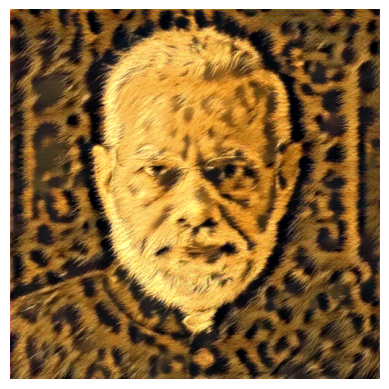

Step 6900, Total Loss: 12830.6845703125


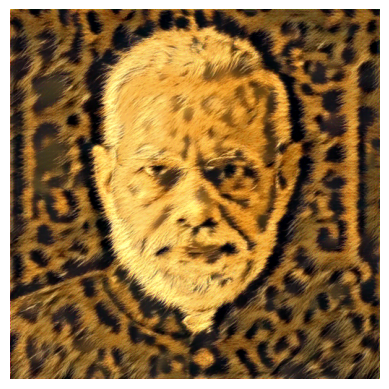

Step 7200, Total Loss: 12793.48828125


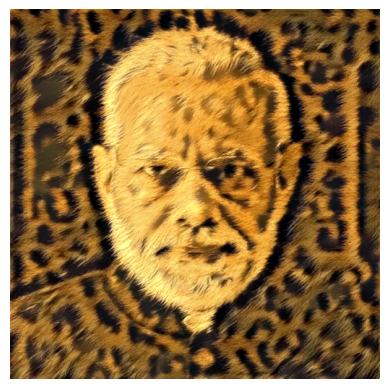

Step 7500, Total Loss: 10001.25


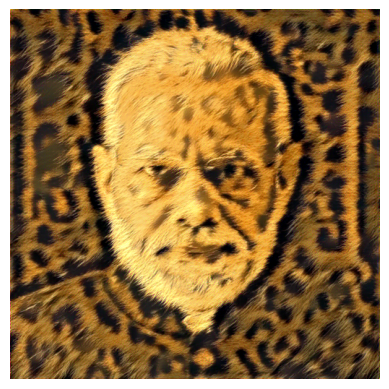

Step 7800, Total Loss: 8994.1572265625


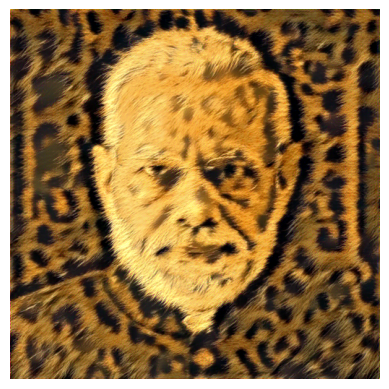

Step 8100, Total Loss: 8511.8662109375


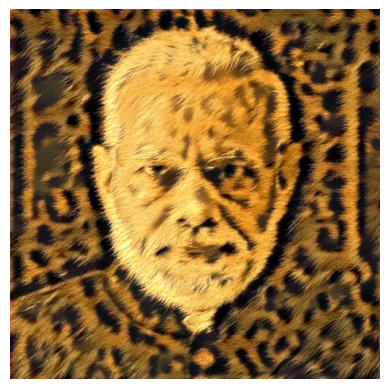

Step 8400, Total Loss: 7679.2265625


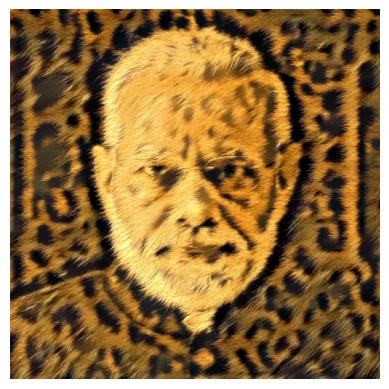

Step 8700, Total Loss: 7631.74462890625


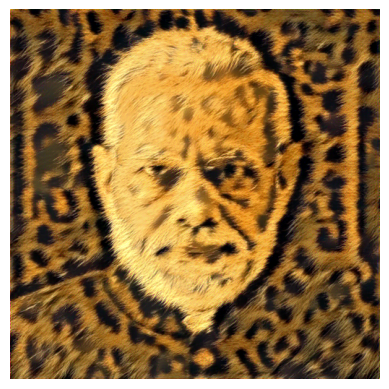

Step 9000, Total Loss: 6755.76904296875


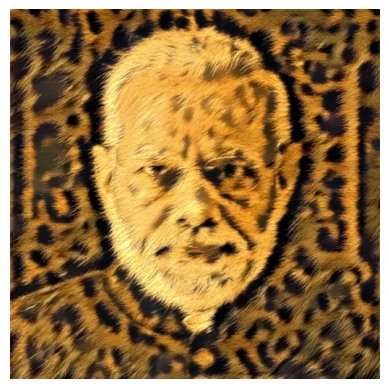

Step 9300, Total Loss: 6396.89111328125


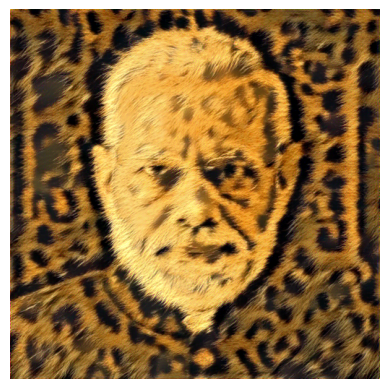

Step 9600, Total Loss: 6023.4384765625


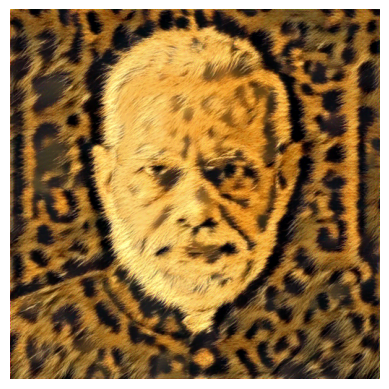

Step 9900, Total Loss: 6476.0615234375


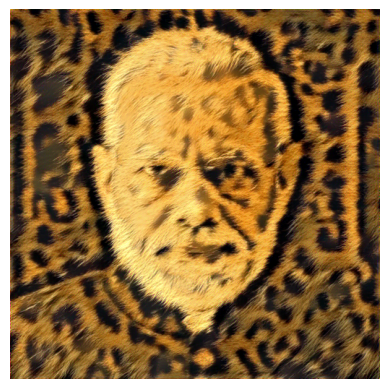

Step 10200, Total Loss: 12928.9765625


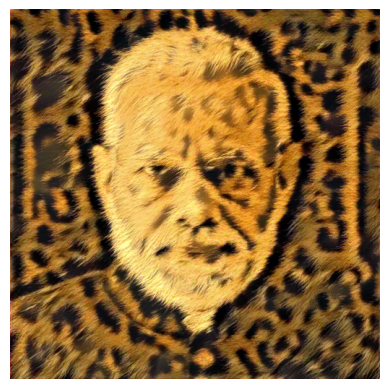

Step 10500, Total Loss: 5318.970703125


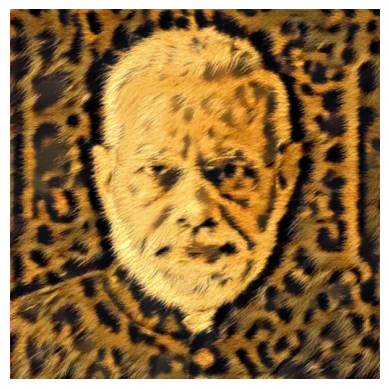

Step 10800, Total Loss: 5868.4228515625


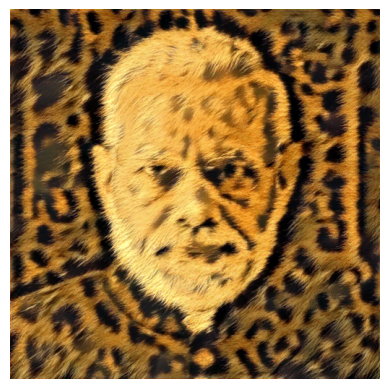

Step 11100, Total Loss: 5138.19775390625


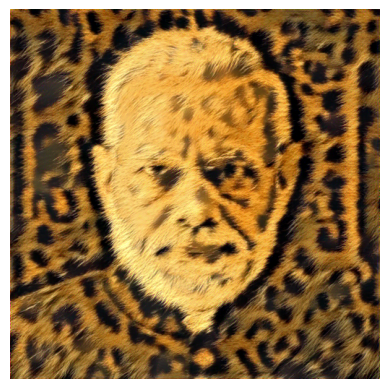

Step 11400, Total Loss: 5040.095703125


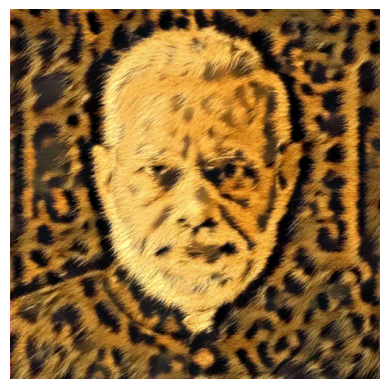

Step 11700, Total Loss: 4993.94287109375


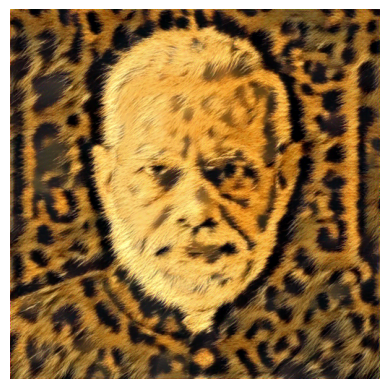

Step 12000, Total Loss: 7178.80078125


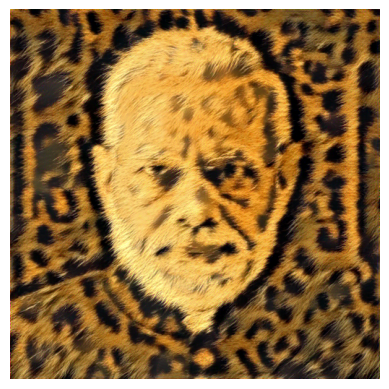

In [16]:
for i in range(1, num_steps+1):
  target_features = get_features(target, vgg)

  content_loss = torch.mean(torch.square(target_features['conv4_2'] - content_features['conv4_2']))

  style_loss = 0.0

  for layer in style_weights:
    target_feature = target_features[layer]
    target_gm = gram_matrix(target_feature)
    style_gm = style_grams[layer]
    layer_style_loss = style_weights[layer] * torch.mean(torch.square(target_gm - style_gm))
    _, d, h, w = target_feature.shape
    style_loss += layer_style_loss / (d * h * w)

  total_loss = content_loss * content_weight + style_loss * style_weight

  optimizer.zero_grad()
  total_loss.backward()
  optimizer.step()

  if i % verbose == 0:
    print(f'Step {i}, Total Loss: {total_loss.item()}')

    plt.imshow(np_convert(target))
    plt.axis('off')
    plt.show()

  if i % cap_frame == 0:
    img_array[ctr] = np_convert(target)
    ctr += 1

(-0.5, 511.5, 511.5, -0.5)

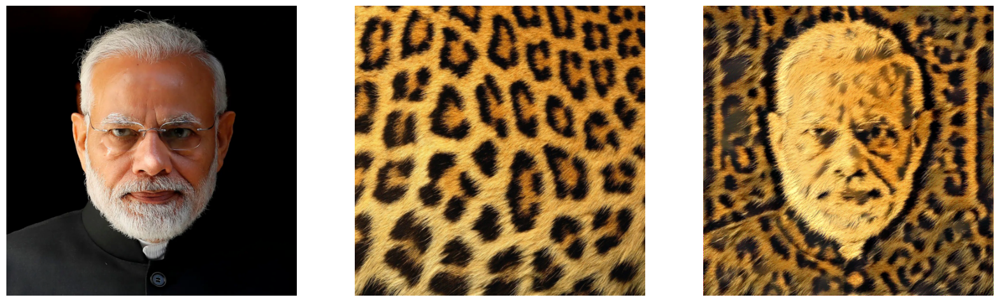

In [17]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))

ax1.imshow(np_convert(content))
ax1.axis('off')

ax2.imshow(np_convert(style))
ax2.axis('off')

ax3.imshow(np_convert(target))


ax3.axis('off')

In [19]:
frame_height, frame_width, _ = np_convert(target).shape
writer = cv2.VideoWriter('modi_chitah_output.mp4', cv2.VideoWriter_fourcc(*'XVID'), 30, (frame_width, frame_height))

for i in range(0, 300):
  img = img_array[i] * 255
  img = img.astype(np.uint8)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  writer.write(img)

writer.release()